<a href="https://colab.research.google.com/github/KangaOnGit/AIO-354-Homework/blob/main/Super_Resolution_(UNet).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install torcheval

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.2/179.2 kB 3.1 MB/s eta 0:00:00


In [2]:
!gdown --id 1bsWkNmmYvBrgE1c58SGJFcCjQv3SUyH3

/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1bsWkNmmYvBrgE1c58SGJFcCjQv3SUyH3
From (redirected): https://drive.google.com/uc?id=1bsWkNmmYvBrgE1c58SGJFcCjQv3SUyH3&confirm=t&uuid=1492dfe6-b5e4-47f3-986a-ab41f6d0e0a5
To: /content/Khoa_LHR_image.zip
100% 89.0M/89.0M [00:01<00:00, 50.8MB/s]


In [3]:
!unzip /content/Khoa_LHR_image.zip

Archive:  /content/Khoa_LHR_image.zip
   creating: Khoa_LHR_image/
   creating: Khoa_LHR_image/train/
  inflating: Khoa_LHR_image/train/0.png  
  inflating: Khoa_LHR_image/train/1.png  
  inflating: Khoa_LHR_image/train/10.png  
  inflating: Khoa_LHR_image/train/100.png  
  inflating: Khoa_LHR_image/train/101.png  
  inflating: Khoa_LHR_image/train/102.png  
  inflating: Khoa_LHR_image/train/103.png  
  inflating: Khoa_LHR_image/train/104.png  
  inflating: Khoa_LHR_image/train/105.png  
  inflating: Khoa_LHR_image/train/106.png  
  inflating: Khoa_LHR_image/train/107.png  
  inflating: Khoa_LHR_image/train/108.png  
  inflating: Khoa_LHR_image/train/109.png  
  inflating: Khoa_LHR_image/train/11.png  
  inflating: Khoa_LHR_image/train/110.png  
  inflating: Khoa_LHR_image/train/111.png  
  inflating: Khoa_LHR_image/train/112.png  
  inflating: Khoa_LHR_image/train/113.png  
  inflating: Khoa_LHR_image/train/114.png  
  inflating: Khoa_LHR_image/train/115.png  
  inflating: Khoa_LHR_im

In [4]:
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torch import optim
from PIL import Image
from torchvision import transforms
import os
import matplotlib.pyplot as plt
import numpy as np
from torcheval.metrics.functional import peak_signal_noise_ratio
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
torch.manual_seed(66)

In [5]:
LHR_TRAIN_DATA_PATH = '/content/Khoa_LHR_image/train'
LHR_VAL_DATA_PATH = '/content/Khoa_LHR_image/val'
BATCH_SIZE = 8
LOW_IMG_HEIGHT = 64
LOW_IMG_WIDTH = 64

# **UNet**

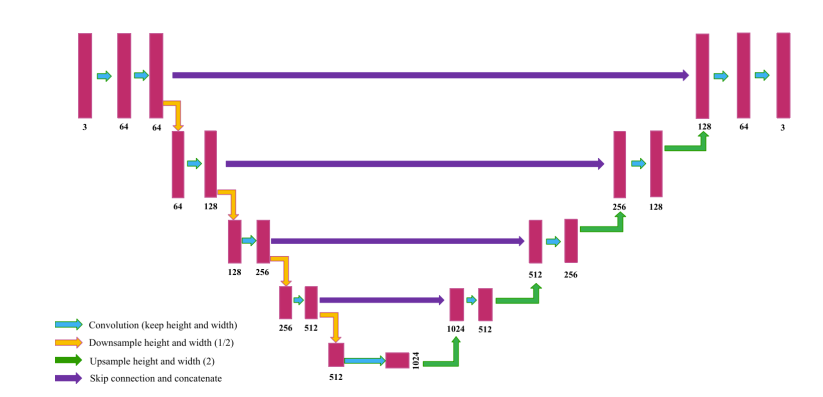


# **First Step**

In [6]:
class FirstStep(nn.Module):
  def __init__(self, in_channels, out_channels):
    super(FirstStep, self).__init__()
    self.conv  = nn.Sequential(
        nn.Conv2d(in_channels, out_channels,
                  kernel_size = 1, stride = 1, padding = 0, bias = False),
        nn.LeakyReLU()
    )

  def forward(self, input):
    return self.conv(input)

# **ConvBlock**

In [7]:
class ConvBlock(nn.Module):
  def __init__(self, in_channels, out_channels):
    super(ConvBlock, self).__init__()
    self.conv = nn.Sequential(
        nn.Conv2d(in_channels, out_channels,
                  kernel_size = 3, stride = 1, padding = 1, bias = False),
        nn.BatchNorm2d(out_channels),
        nn.LeakyReLU(inplace = True),

        nn.Conv2d(out_channels, out_channels,
                 kernel_size = 3, stride = 1, padding = 1, bias = False),
        nn.BatchNorm2d(out_channels),
        nn.LeakyReLU(inplace = True)
    )
  def forward(self, input):
    return self.conv(input)

# **Encoder Block**

In [8]:
class Encoder(nn.Module):
  def __init__(self, in_channels, out_channels) -> None:
    super(Encoder, self).__init__()
    # Downsample Height, Width to half the original
    self.encoder = nn.Sequential(
        nn.MaxPool2d(2),
        ConvBlock(in_channels, out_channels)
    )
  def forward(self, input):
    return self.encoder(input)

# **Decoder Block (No Skip Connection)**

In [9]:
class DecoderNoSkip(nn.Module):
  def __init__(self, in_channels, out_channels):
    super(DecoderNoSkip, self).__init__()
    self.decoder = nn.Sequential(
        nn.UpsamplingBilinear2d(scale_factor = 2), # x2 Height and Width
        nn.Conv2d(in_channels, out_channels*2,
                  kernel_size = 1, stride = 1, padding = 0, bias = False),
        nn.BatchNorm2d(out_channels*2),
        nn.LeakyReLU()
    )
    # No Skip Connection so we have to double out_channel size to keep the same res
    self.conv_block = ConvBlock(out_channels*2, out_channels)

  def forward(self, input):
    x = self.decoder(input)
    x = self.conv_block(x)
    return x

# **Decoder Block Skip Connection**

In [10]:
class Decoder(nn.Module):
  def __init__(self, in_channels, out_channels):
    super(Decoder, self).__init__()
    self.decoder = nn.Sequential(
        nn.UpsamplingBilinear2d(scale_factor = 2),
        nn.Conv2d(in_channels, out_channels,
                  kernel_size = 1, stride = 1, padding = 0, bias = False),
        nn.BatchNorm2d(out_channels),
        nn.LeakyReLU()
    )
    # We Concatenate the Information before pushing through ConvBlock
    """
      Special Case, in_channels = 2*out_channels
    """
    self.conv_block = ConvBlock(in_channels, out_channels)

  def forward(self, input, skip):
    x = self.decoder(input)
    # Skip Connection (Save Resolution Information) | Channel-wise concatenation
    x = torch.concat([x, skip], dim = 1) # (Batch, Channel, Height, Width)
    x = self.conv_block(x)
    return x

# **Final Step**

In [11]:
class FinalStep(nn.Module):
  def __init__(self, in_channels, out_channels):
    super(FinalStep, self).__init__()
    self.conv = nn.Sequential(
        nn.Conv2d(in_channels, out_channels, kernel_size = 1,
                  stride = 1, padding = 0, bias = False),
        nn.Tanh() # Classification (-1, 1)
    )

  def forward(self, input):
    return self.conv(input)

# **UNet (No Skip Connection)**

In [12]:
class UNetNoSkip(nn.Module):
  def __init__(self, n_channels = 3, n_classes = 3,
               features = [64, 128, 256, 512]):
    super(UNetNoSkip, self).__init__()

    self.n_channels = n_channels
    self.n_classes = n_classes
    # 4 Times Image Size
    self.resize_fnc = transforms.Resize((LOW_IMG_HEIGHT*4,
                                         LOW_IMG_HEIGHT*4), antialias = True)
    self.in_conv1 = FirstStep(n_channels, 64)
    self.in_conv2 = ConvBlock(64, 64)

    self.enc_1 = Encoder(64, 128)
    self.enc_2 = Encoder(128, 256)
    self.enc_3 = Encoder(256, 512)
    self.enc_4 = Encoder(512, 1024)

    self.dec_1 = DecoderNoSkip(1024, 512)
    self.dec_2 = DecoderNoSkip(512, 256)
    self.dec_3 = DecoderNoSkip(256, 128)
    self.dec_4 = DecoderNoSkip(128, 64)

    self.out = FinalStep(64, n_classes)

  def forward(self, input):
    x = self.resize_fnc(input)
    # First Step
    x = self.in_conv1(x)

    # Second Block
    x = self.in_conv2(x)

    # 4 Down Steps
    x = self.enc_1(x)
    x = self.enc_2(x)
    x = self.enc_3(x)
    x = self.enc_4(x)

    # 4 Up Steps
    x = self.dec_1(x)
    x = self.dec_2(x)
    x = self.dec_3(x)
    x = self.dec_4(x)

    # Output
    x = self.out(x)

    return x

# **UNet (Skip Connection)**

In [13]:
class UNet(nn.Module):
  def __init__(self, n_channels = 3, n_classes = 3,
               features = [64, 128, 256, 512]):
    super(UNet, self).__init__()
    # 4 Times Image Size
    self.resize_fnc = transforms.Resize((LOW_IMG_HEIGHT*4,
                                         LOW_IMG_HEIGHT*4), antialias = True)
    self.n_channels = n_channels
    self.n_classes = n_classes

    self.in_conv1 = FirstStep(n_channels, 64)
    self.in_conv2 = ConvBlock(64, 64)

    self.enc_1 = Encoder(64, 128)
    self.enc_2 = Encoder(128, 256)
    self.enc_3 = Encoder(256, 512)
    self.enc_4 = Encoder(512, 1024)

    self.dec_1 = Decoder(1024, 512)
    self.dec_2 = Decoder(512, 256)
    self.dec_3 = Decoder(256, 128)
    self.dec_4 = Decoder(128, 64)

    self.out = FinalStep(64, n_classes)

  def forward(self, input):
    x = self.resize_fnc(input)
    # First Step
    x = self.in_conv1(x)

    # Second Block
    x1 = self.in_conv2(x)

    # 4 Down Steps
    x2 = self.enc_1(x1)
    x3 = self.enc_2(x2)
    x4 = self.enc_3(x3)
    x5 = self.enc_4(x4)

    # 4 Up Steps
    x = self.dec_1(x5, x4)
    x = self.dec_2(x, x3)
    x = self.dec_3(x, x2)
    x = self.dec_4(x, x1)

    # Output
    x = self.out(x)

    return x

# **Dataset**

In [14]:
class ImageDataset(Dataset):
  def __init__(self, img_dir, is_train = True):
    self.resize = transforms.Resize(
        (LOW_IMG_WIDTH, LOW_IMG_HEIGHT), antialias = True)
    self.is_train = is_train
    self.img_dir = img_dir
    self.images = os.listdir(img_dir) # Open Image Directory

  def __len__(self):
    return len(self.images) # Number of Imaes in Imgage Directory

  def normalize(self, input_img, target_img):
    input_img = input_img*2 - 1
    target_img = target_img*2 - 1

    return input_img, target_img

  def random_jitter(self, input_img, target_img):
    if torch.rand([]) < .5:
      input_img = transforms.functional.hflip(input_img)
      target_img = transforms.functional.hflip(target_img)

    return input_img, target_img

  def __getitem__(self, idx):
    img_path = os.path.join(self.img_dir, self.images[idx])
    img = np.array(Image.open(img_path).convert("RGB")) # Convert to RGB
    img = transforms.functional.to_tensor(img) # Convert to Pytorch Tensor
    input_img = self.resize(img).type(torch.float32)
    target_img = img.type(torch.float32)

    input_img, target_img = self.normalize(input_img, target_img)

    if self.is_train:
      input_img, target_img = self.random_jitter(input_img, target_img)

    return input_img, target_img

In [15]:
train_dataset = ImageDataset(LHR_TRAIN_DATA_PATH, is_train=True)
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = ImageDataset(LHR_VAL_DATA_PATH, is_train=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

# **Train**

In [16]:
def generate_images(model, inputs, labels):
    model.eval()
    with torch.no_grad():
        inputs, labels = inputs.to(device), labels.to(device)
        predictions = model(inputs)
    inputs, labels, predictions = inputs.cpu().numpy(), labels.cpu().numpy(), predictions.cpu().numpy()
    plt.figure(figsize=(15,20))

    display_list = [inputs[-1].transpose((1, 2, 0)), labels[-1].transpose((1, 2, 0)), predictions[-1].transpose((1, 2, 0))]
    title = ['Input', 'Real', 'Predicted']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] + 1) / 2)
        plt.axis('off')
    plt.show()

In [17]:
def evaluate_epoch(model, criterion, val_set, device):
    model.eval()
    total_psnr, total_count = 0, 0
    losses = []

    with torch.no_grad():
        for idx, (inputs, labels) in enumerate(val_set):
            inputs = inputs.to(device)
            labels = labels.to(device)

            predictions = model(inputs)

            loss = criterion(predictions, labels)
            losses.append(loss.item())


            total_psnr +=  peak_signal_noise_ratio(predictions, labels)
            total_count += 1

    epoch_psnr = total_psnr / total_count
    epoch_loss = sum(losses) / len(losses)
    return epoch_psnr, epoch_loss

In [18]:
import time

def train_epoch(model, optimizer, criterion, train_dataloader, device, epoch=0,
                log_interval=50):
    model.train()
    total_psnr, total_count = 0, 0
    losses = []
    start_time = time.time()

    for idx, (inputs, labels) in enumerate(train_dataloader):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        predictions = model(inputs)

        # compute loss
        loss = criterion(predictions, labels)
        losses.append(loss.item())

        # backward
        loss.backward()
        optimizer.step()

        total_psnr += peak_signal_noise_ratio(predictions, labels)
        total_count += 1
        if idx % log_interval == 0 and idx > 0:
            elapsed = time.time() - start_time
            print(
                "| epoch {:3d} | {:5d}/{:5d} batches "
                "| psnr {:8.3f}".format(
                    epoch, idx, len(train_dataloader), total_psnr / total_count
                )
            )
            total_psnr, total_count = 0, 0
            start_time = time.time()

    epoch_psnr = total_psnr / total_count
    epoch_loss = sum(losses) / len(losses)
    return epoch_psnr, epoch_loss

In [19]:
def train(model, model_name, save_model, optimizer, criterion, train_dataloader, valid_dataloader, num_epochs, device):
    train_psnrs, train_losses = [], []
    eval_psnrs, eval_losses = [], []
    best_psnr_eval = -1000
    times = []
    for epoch in range(1, num_epochs+1):
        epoch_start_time = time.time()
        # Training
        train_psnr, train_loss = train_epoch(model, optimizer, criterion, train_dataloader, device, epoch)
        train_psnrs.append(train_psnr.cpu())
        train_losses.append(train_loss)

        # Evaluation
        eval_psnr, eval_loss = evaluate_epoch(model, criterion, valid_dataloader, device)
        eval_psnrs.append(eval_psnr.cpu())
        eval_losses.append(eval_loss)

        # Save best model
        if best_psnr_eval < eval_psnr :
            torch.save(model.state_dict(), save_model + f'/{model_name}.pt')
            inputs_t, targets_t = next(iter(valid_dataloader))
            generate_images(model, inputs_t, targets_t)
            best_psnr_eval = eval_psnr
        times.append(time.time() - epoch_start_time)
        # Print loss, psnr end epoch
        print("-" * 59)
        print(
            "| End of epoch {:3d} | Time: {:5.2f}s | Train psnr {:8.3f} | Train Loss {:8.3f} "
            "| Valid psnr {:8.3f} | Valid Loss {:8.3f} ".format(
                epoch, time.time() - epoch_start_time, train_psnr, train_loss, eval_psnr, eval_loss
            )
        )
        print("-" * 59)

    # Load best model
    model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))
    model.eval()
    metrics = {
        'train_psnr': train_psnrs,
        'train_loss': train_losses,
        'valid_psnr': eval_psnrs,
        'valid_loss': eval_losses,
        'time': times
    }
    return model, metrics

In [20]:
import matplotlib.pyplot as plt

def plot_result(num_epochs, train_psnrs, eval_psnrs, train_losses, eval_losses):
    epochs = list(range(num_epochs))
    fig, axs = plt.subplots(nrows = 1, ncols =2 , figsize = (12,6))
    axs[0].plot(epochs, train_psnrs, label = "Training")
    axs[0].plot(epochs, eval_psnrs, label = "Evaluation")
    axs[1].plot(epochs, train_losses, label = "Training")
    axs[1].plot(epochs, eval_losses, label = "Evaluation")
    axs[0].set_xlabel("Epochs")
    axs[1].set_xlabel("Epochs")
    axs[0].set_ylabel("PSNR")
    axs[1].set_ylabel("Loss")
    plt.legend()

In [21]:
import matplotlib.pyplot as plt

def predict_and_display(model, test_dataloader, device):
    model.eval()

    with torch.no_grad():
        for idx, (inputs, labels) in enumerate(test_dataloader):
            if idx >= 10:
                break
            inputs = inputs.to(device)
            predictions = model(inputs)
            generate_images(model, inputs, labels)
            plt.show()

# **UNet (No Skip Connection) Results**

| epoch   1 |    50/   86 batches | psnr   14.712


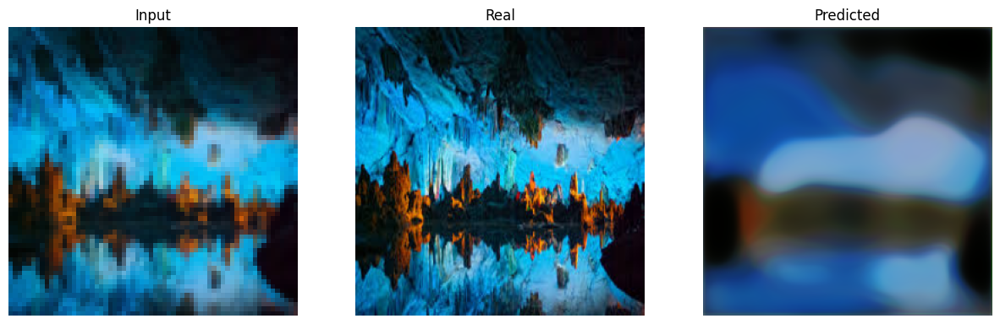

-----------------------------------------------------------
| End of epoch   1 | Time: 54.23s | Train psnr   16.109 | Train Loss    0.257 | Valid psnr   16.793 | Valid Loss    0.203 
-----------------------------------------------------------
| epoch   2 |    50/   86 batches | psnr   16.252


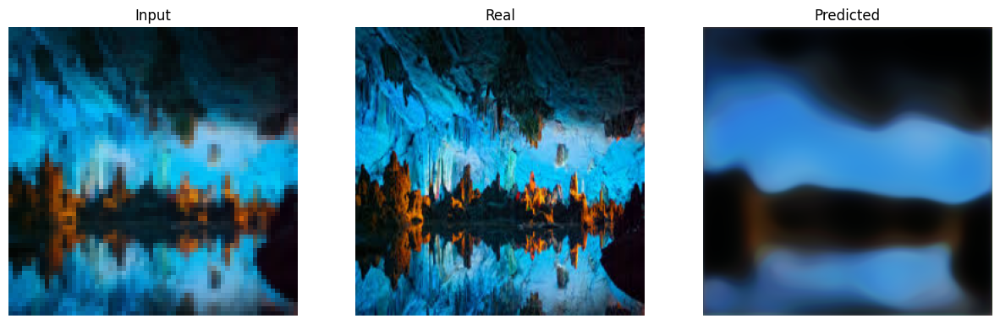

-----------------------------------------------------------
| End of epoch   2 | Time: 55.86s | Train psnr   16.775 | Train Loss    0.210 | Valid psnr   17.188 | Valid Loss    0.183 
-----------------------------------------------------------
| epoch   3 |    50/   86 batches | psnr   17.073
-----------------------------------------------------------
| End of epoch   3 | Time: 55.09s | Train psnr   15.982 | Train Loss    0.207 | Valid psnr   16.997 | Valid Loss    0.204 
-----------------------------------------------------------
| epoch   4 |    50/   86 batches | psnr   16.471


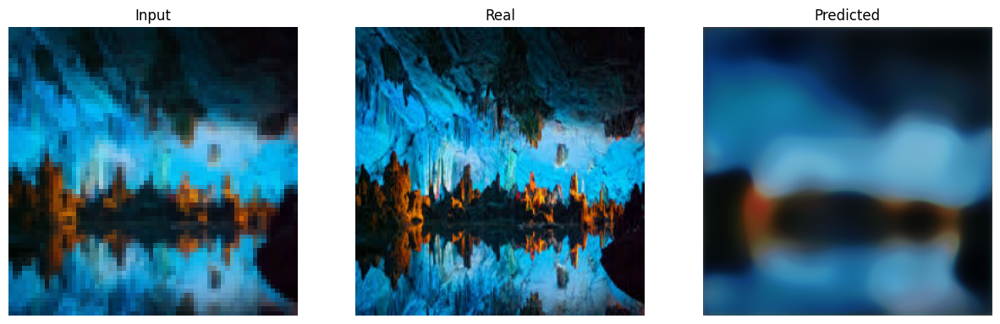

-----------------------------------------------------------
| End of epoch   4 | Time: 56.29s | Train psnr   17.050 | Train Loss    0.203 | Valid psnr   17.389 | Valid Loss    0.189 
-----------------------------------------------------------
| epoch   5 |    50/   86 batches | psnr   17.394


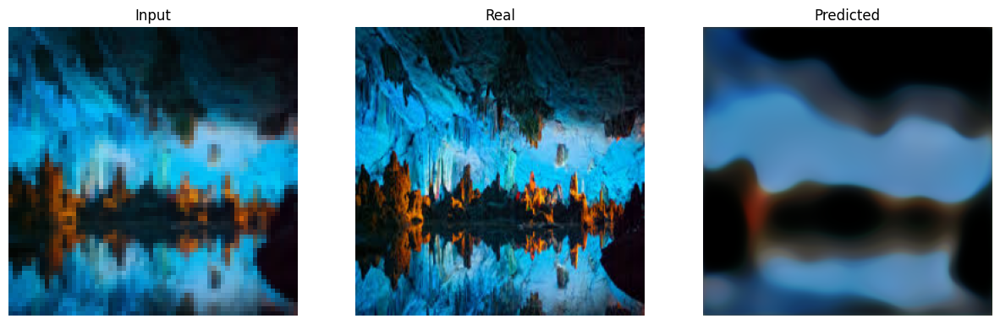

-----------------------------------------------------------
| End of epoch   5 | Time: 55.97s | Train psnr   16.693 | Train Loss    0.192 | Valid psnr   17.396 | Valid Loss    0.183 
-----------------------------------------------------------
| epoch   6 |    50/   86 batches | psnr   17.300


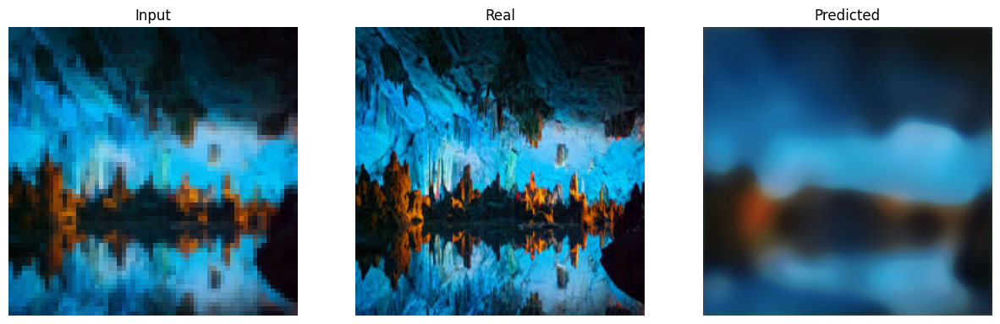

-----------------------------------------------------------
| End of epoch   6 | Time: 56.27s | Train psnr   17.434 | Train Loss    0.187 | Valid psnr   18.036 | Valid Loss    0.172 
-----------------------------------------------------------
| epoch   7 |    50/   86 batches | psnr   17.711
-----------------------------------------------------------
| End of epoch   7 | Time: 55.11s | Train psnr   17.794 | Train Loss    0.176 | Valid psnr   16.925 | Valid Loss    0.198 
-----------------------------------------------------------
| epoch   8 |    50/   86 batches | psnr   17.972


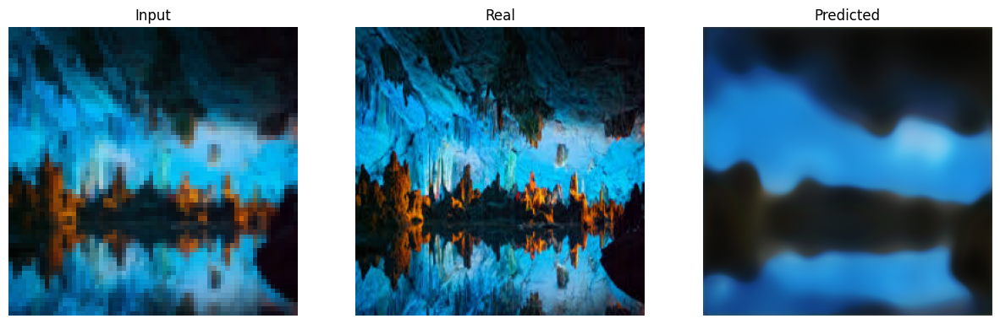

-----------------------------------------------------------
| End of epoch   8 | Time: 56.55s | Train psnr   18.101 | Train Loss    0.170 | Valid psnr   18.329 | Valid Loss    0.159 
-----------------------------------------------------------
| epoch   9 |    50/   86 batches | psnr   18.112
-----------------------------------------------------------
| End of epoch   9 | Time: 55.25s | Train psnr   18.166 | Train Loss    0.167 | Valid psnr   17.163 | Valid Loss    0.184 
-----------------------------------------------------------
| epoch  10 |    50/   86 batches | psnr   18.214


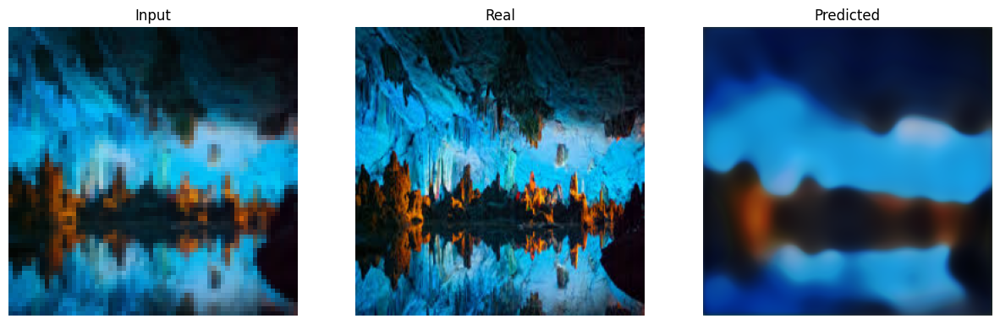

-----------------------------------------------------------
| End of epoch  10 | Time: 56.21s | Train psnr   18.439 | Train Loss    0.163 | Valid psnr   18.729 | Valid Loss    0.151 
-----------------------------------------------------------


<ipython-input-19-9140fde4fd84>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))


In [22]:
import torch.optim as optim

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
unet_model_noskip = UNetNoSkip().to(device)
unet_model_noskip.to(device)

criterion = nn.L1Loss()

optimizer = optim.Adam(unet_model_noskip.parameters(), lr=1e-4, betas=[0.5,0.999])

save_model = './UNET'
os.makedirs(save_model, exist_ok = True)

EPOCHS = 10 # Change this to like 100 if you want better results (I AM NOT WAITING 1 HOUR AND 40 MINUTES)
unet_model_noskip, metrics = train(
    unet_model_noskip, 'unet_model_noskip', save_model, optimizer, criterion, train_loader, test_loader, EPOCHS, device
)

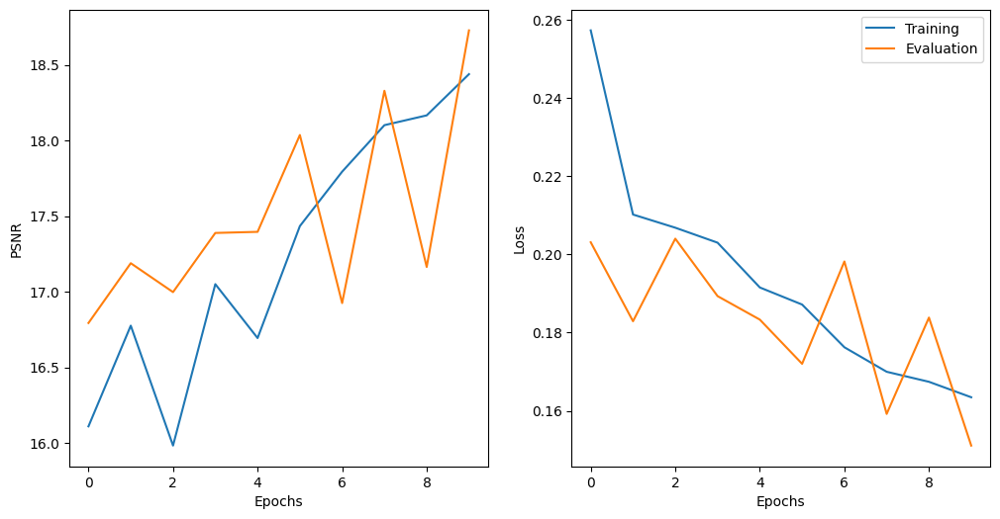

In [23]:
plot_result(
    EPOCHS,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [24]:
test_psnr, test_loss = evaluate_epoch(unet_model_noskip, criterion, test_loader, device)
test_psnr, test_loss

(tensor(18.7286, device='cuda:0'), 0.15113995291969992)

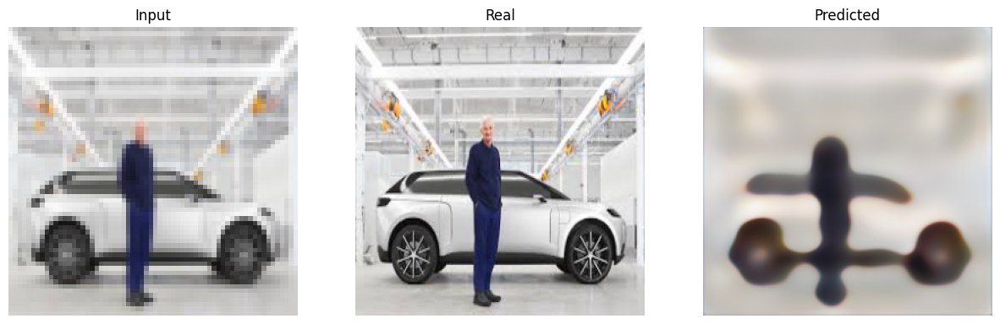

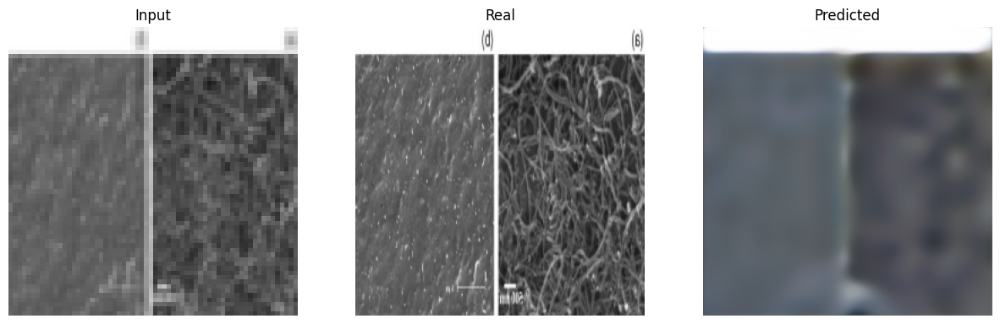

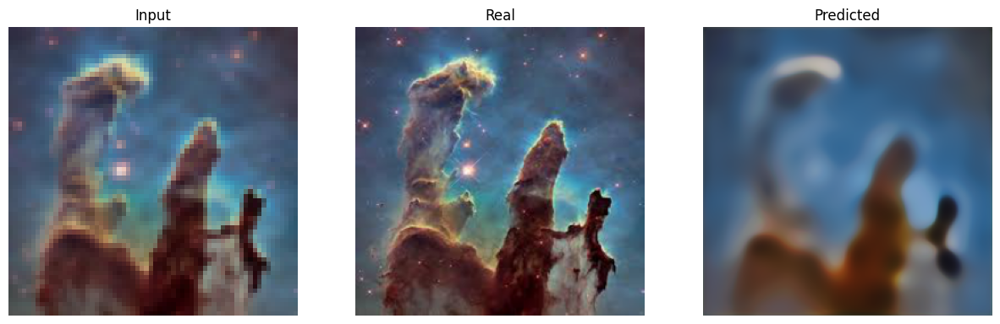

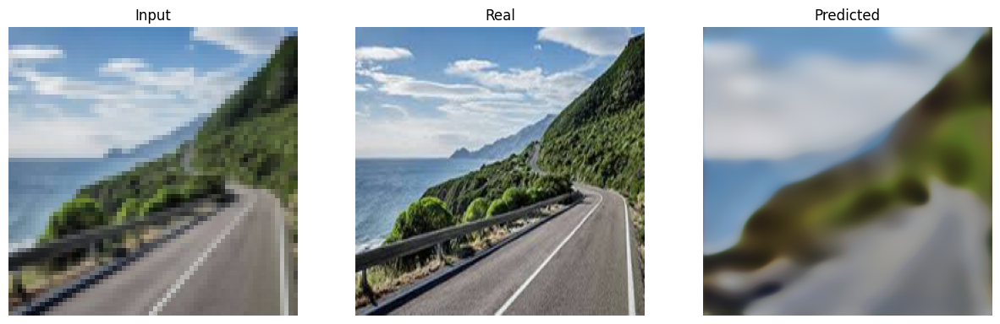

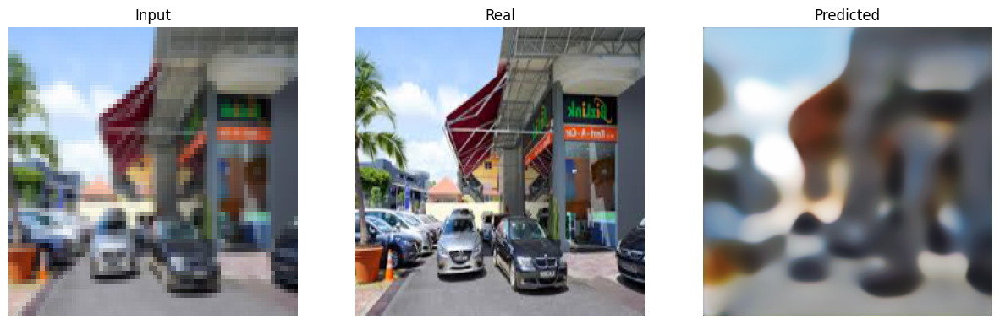

...

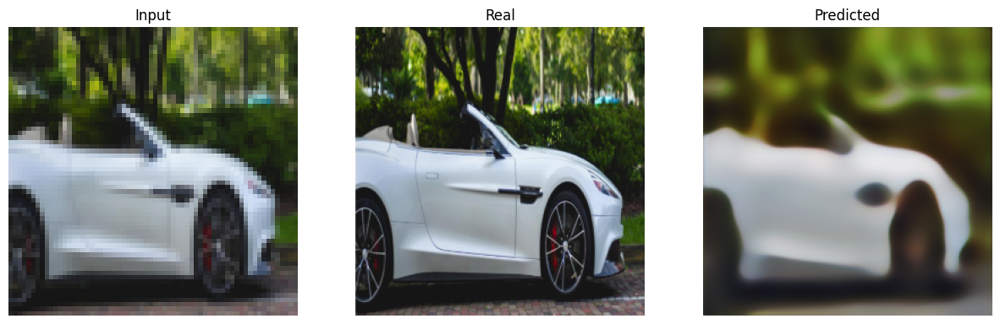

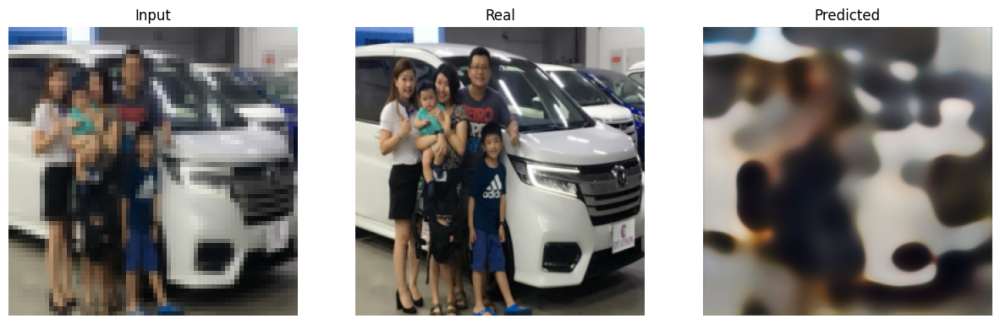

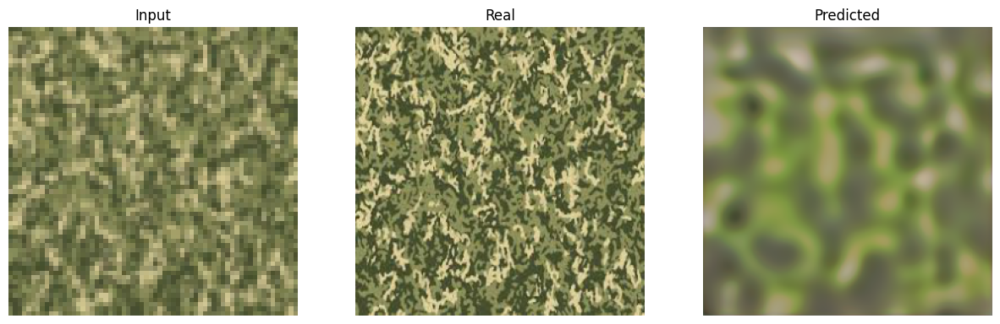

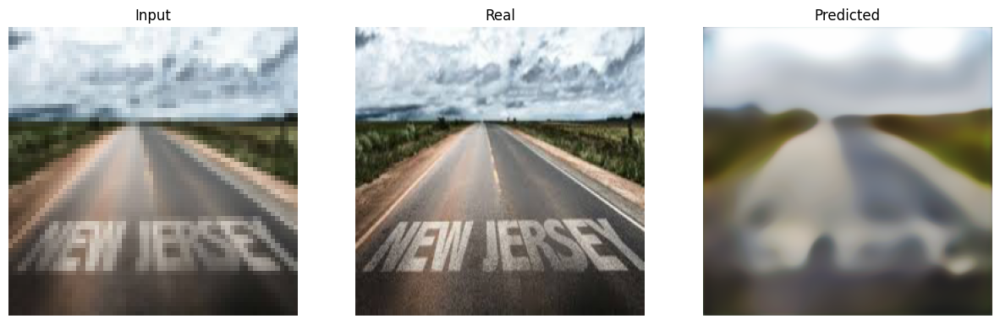

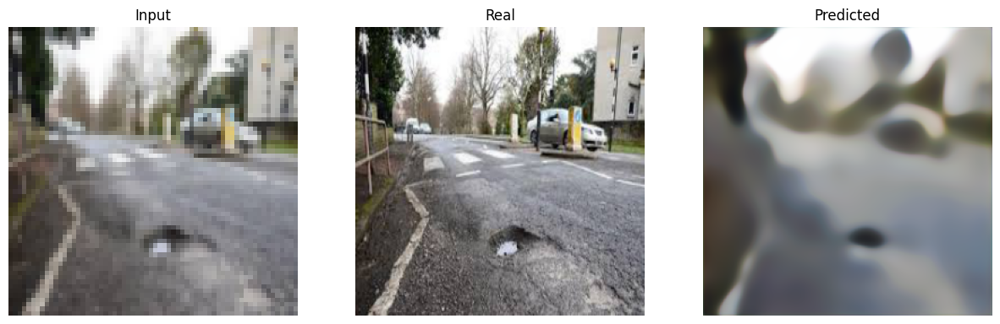

In [25]:
predict_and_display(unet_model_noskip, train_loader, device)
predict_and_display(unet_model_noskip, test_loader, device)

# **UNet (Skip Connection) Results**

| epoch   1 |    50/   86 batches | psnr   19.296


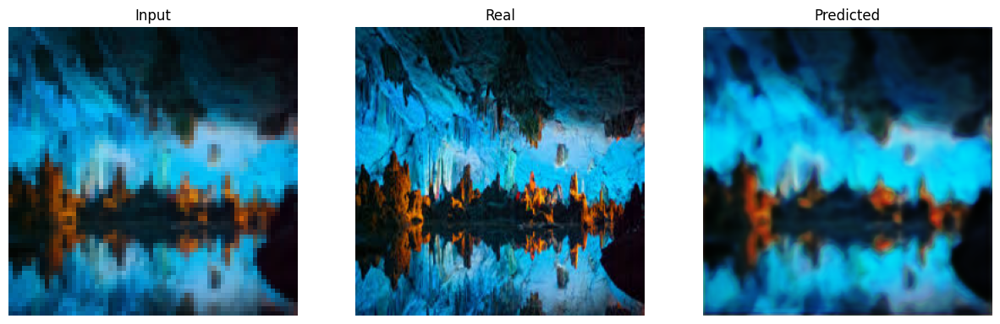

-----------------------------------------------------------
| End of epoch   1 | Time: 53.86s | Train psnr   20.536 | Train Loss    0.156 | Valid psnr   22.090 | Valid Loss    0.108 
-----------------------------------------------------------
| epoch   2 |    50/   86 batches | psnr   21.932


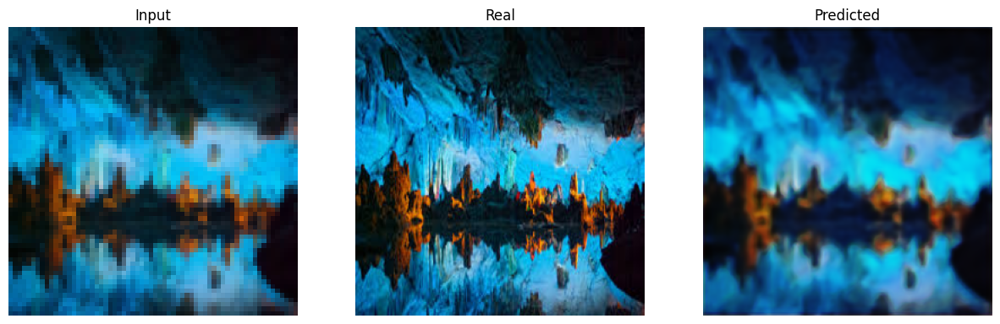

-----------------------------------------------------------
| End of epoch   2 | Time: 53.81s | Train psnr   21.616 | Train Loss    0.117 | Valid psnr   23.007 | Valid Loss    0.092 
-----------------------------------------------------------
| epoch   3 |    50/   86 batches | psnr   22.574


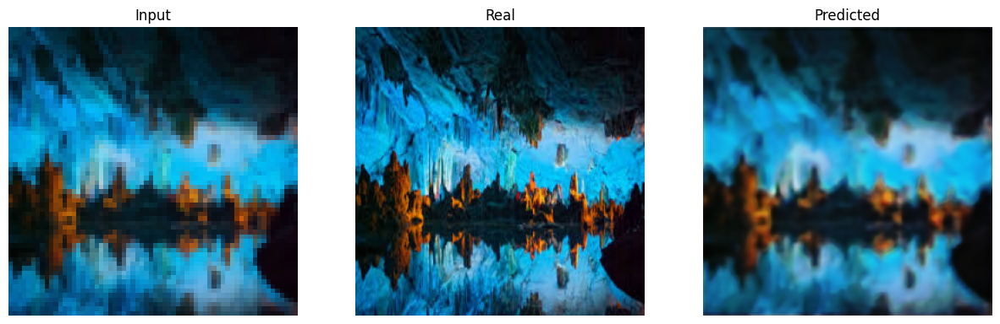

-----------------------------------------------------------
| End of epoch   3 | Time: 53.81s | Train psnr   22.687 | Train Loss    0.104 | Valid psnr   23.280 | Valid Loss    0.085 
-----------------------------------------------------------
| epoch   4 |    50/   86 batches | psnr   23.076


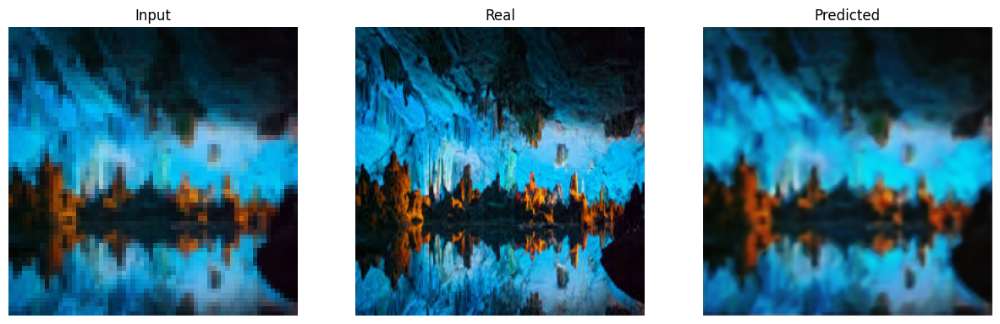

-----------------------------------------------------------
| End of epoch   4 | Time: 53.28s | Train psnr   22.997 | Train Loss    0.098 | Valid psnr   23.630 | Valid Loss    0.086 
-----------------------------------------------------------
| epoch   5 |    50/   86 batches | psnr   23.229


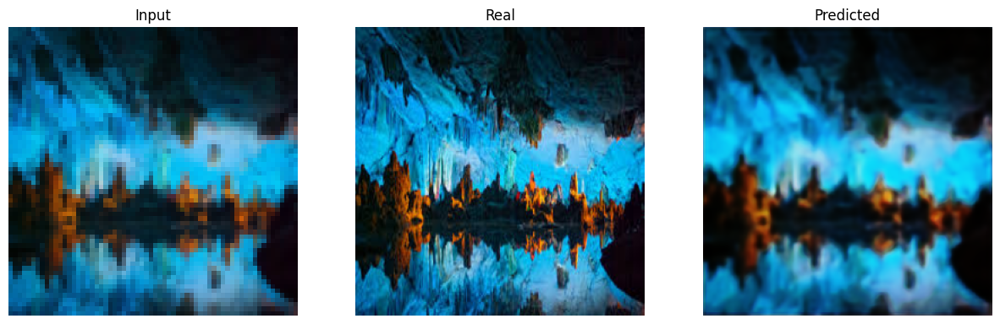

-----------------------------------------------------------
| End of epoch   5 | Time: 53.38s | Train psnr   23.433 | Train Loss    0.094 | Valid psnr   23.871 | Valid Loss    0.084 
-----------------------------------------------------------
| epoch   6 |    50/   86 batches | psnr   23.326


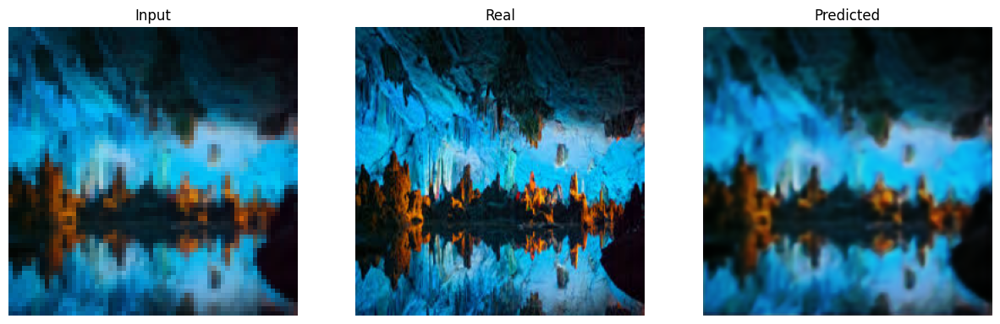

-----------------------------------------------------------
| End of epoch   6 | Time: 53.30s | Train psnr   23.515 | Train Loss    0.094 | Valid psnr   24.310 | Valid Loss    0.076 
-----------------------------------------------------------
| epoch   7 |    50/   86 batches | psnr   23.543
-----------------------------------------------------------
| End of epoch   7 | Time: 53.41s | Train psnr   23.524 | Train Loss    0.090 | Valid psnr   23.765 | Valid Loss    0.086 
-----------------------------------------------------------
| epoch   8 |    50/   86 batches | psnr   23.847
-----------------------------------------------------------
| End of epoch   8 | Time: 52.56s | Train psnr   23.521 | Train Loss    0.089 | Valid psnr   24.275 | Valid Loss    0.078 
-----------------------------------------------------------
| epoch   9 |    50/   86 batches | psnr   23.828


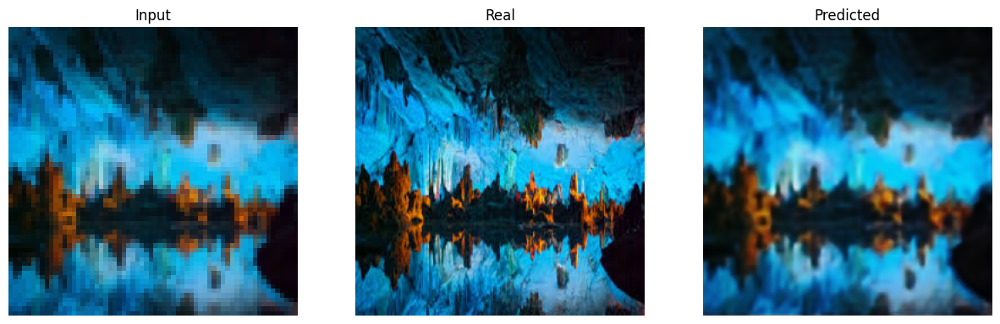

-----------------------------------------------------------
| End of epoch   9 | Time: 53.07s | Train psnr   24.029 | Train Loss    0.086 | Valid psnr   24.549 | Valid Loss    0.073 
-----------------------------------------------------------
| epoch  10 |    50/   86 batches | psnr   23.540


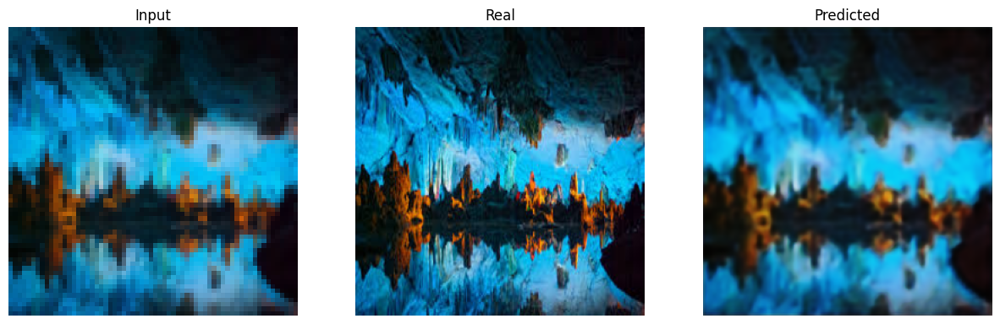

-----------------------------------------------------------
| End of epoch  10 | Time: 53.15s | Train psnr   24.216 | Train Loss    0.087 | Valid psnr   24.596 | Valid Loss    0.073 
-----------------------------------------------------------


<ipython-input-19-9140fde4fd84>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))


In [26]:
import torch.optim as optim

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
unet_model = UNet().to(device)
unet_model.to(device)

criterion = nn.L1Loss()

optimizer = optim.Adam(unet_model.parameters(), lr=1e-4, betas=[0.5,0.999])

save_model = './UNET'
os.makedirs(save_model, exist_ok = True)

EPOCHS = 10 # Change this to like 100 if you want better results (I AM NOT WAITING 1 HOUR AND 40 MINUTES)
unet_model, metrics = train(
    unet_model, 'SR_unet_model', save_model, optimizer, criterion, train_loader, test_loader, EPOCHS, device
)

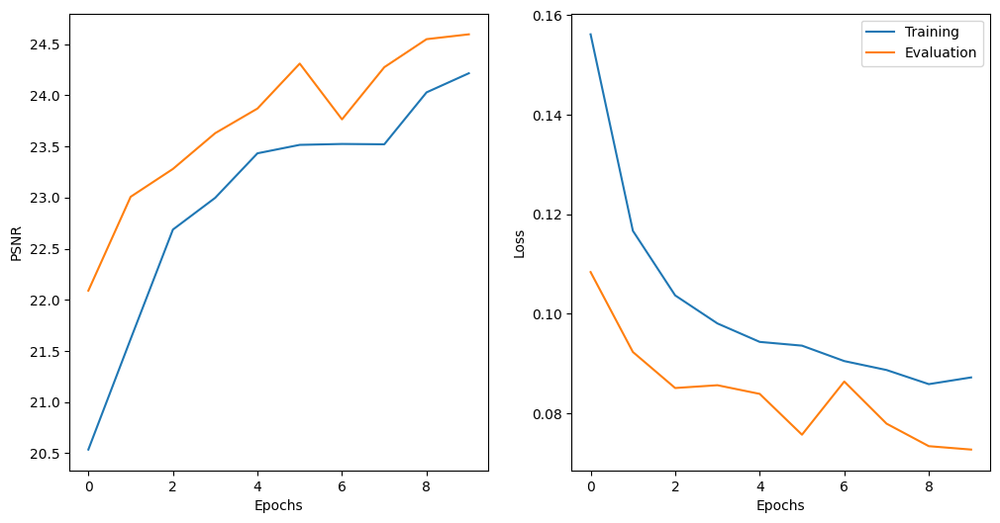

In [27]:
plot_result(
    EPOCHS,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [28]:
test_psnr, test_loss = evaluate_epoch(unet_model, criterion, test_loader, device)
test_psnr, test_loss

(tensor(24.5963, device='cuda:0'), 0.072689383036711)

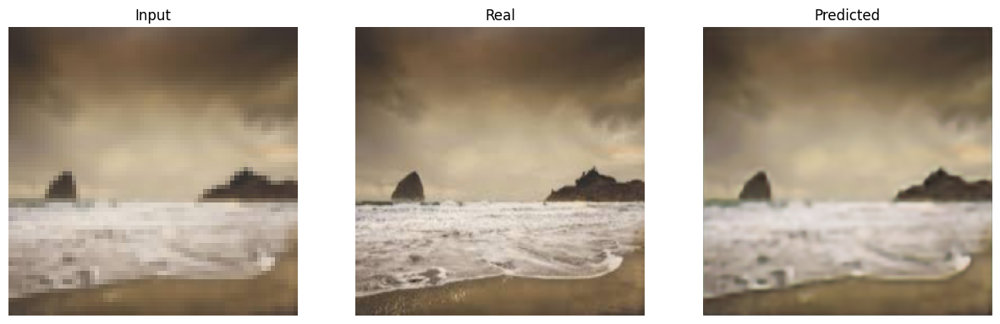

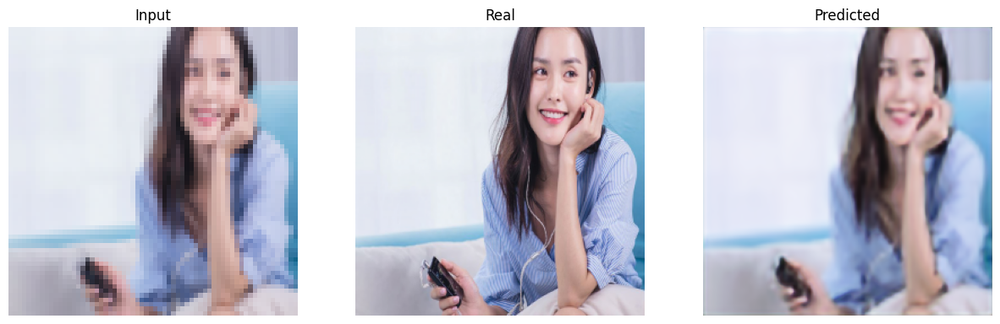

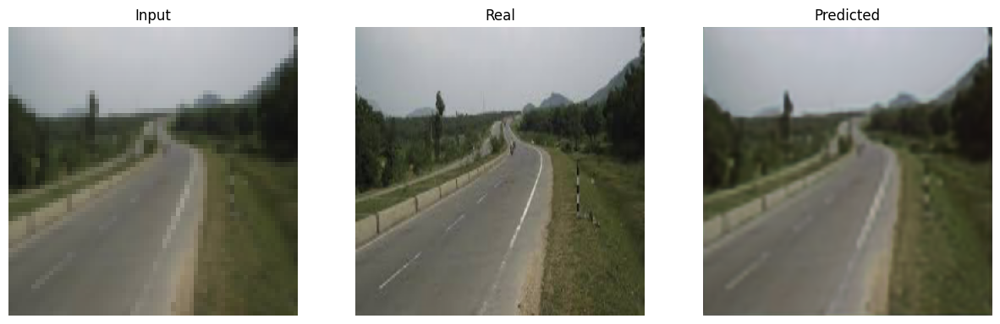

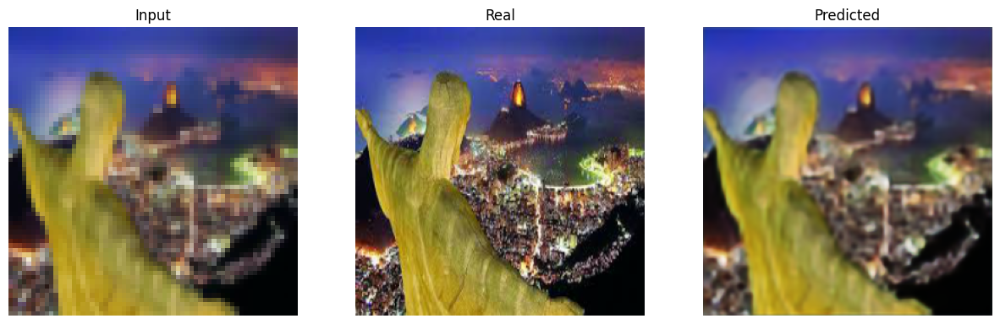

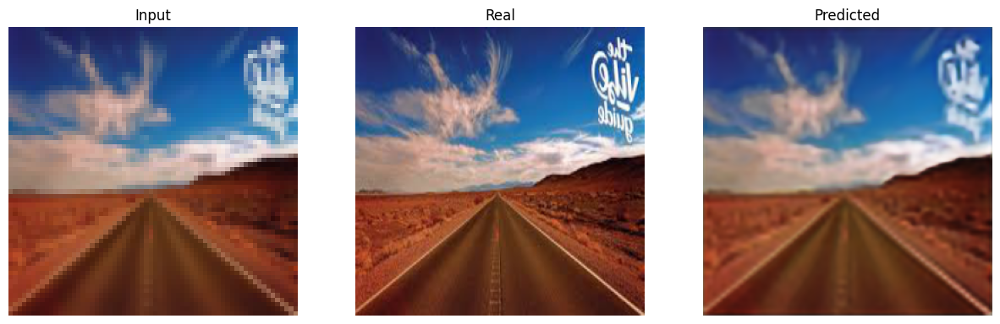

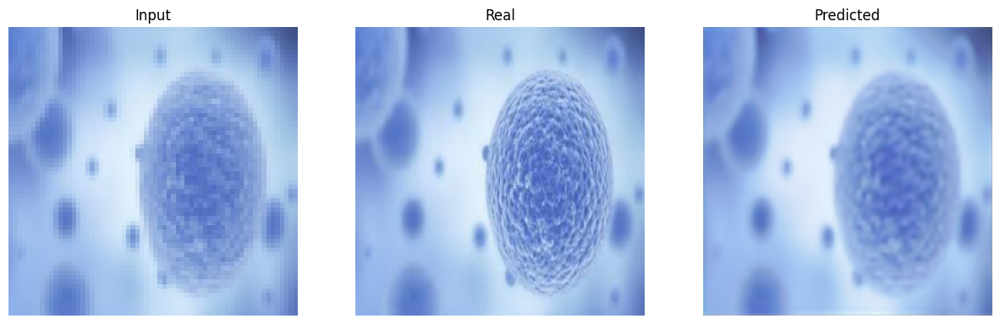

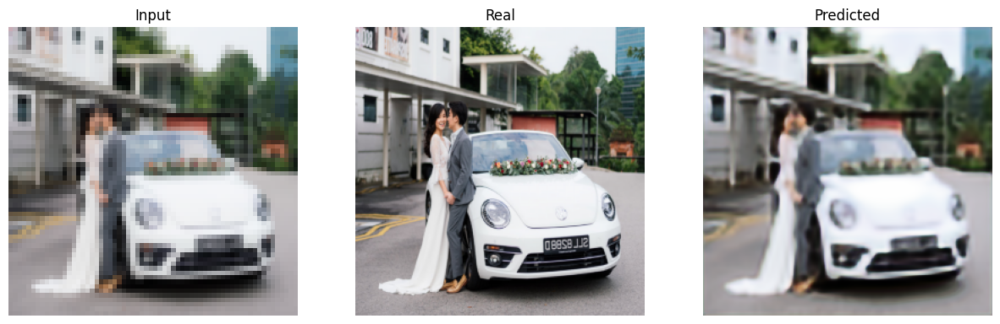

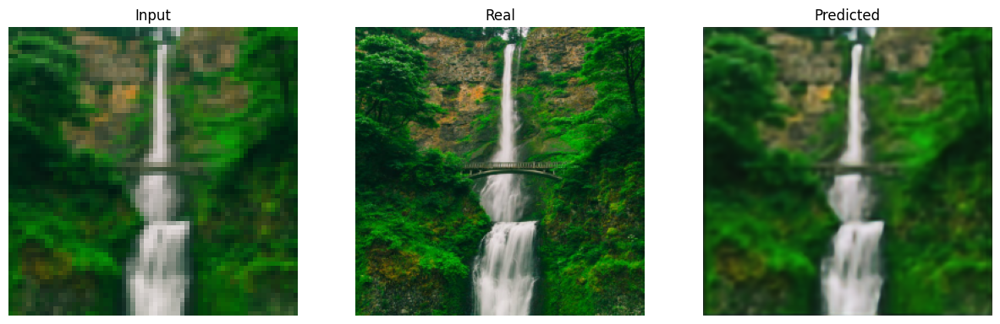

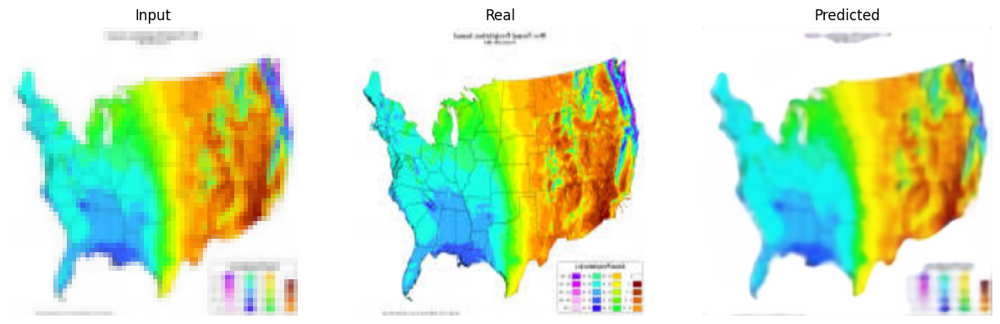

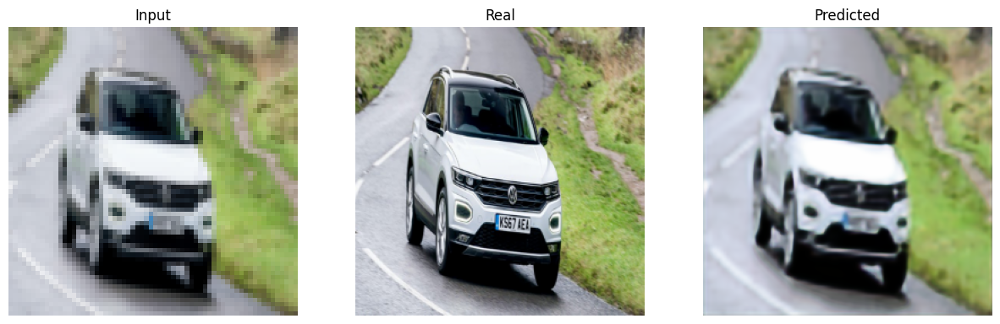

In [29]:
predict_and_display(unet_model, train_loader, device)

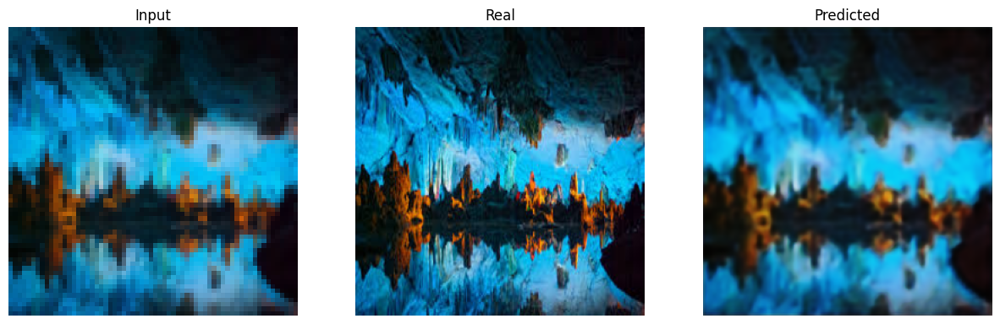

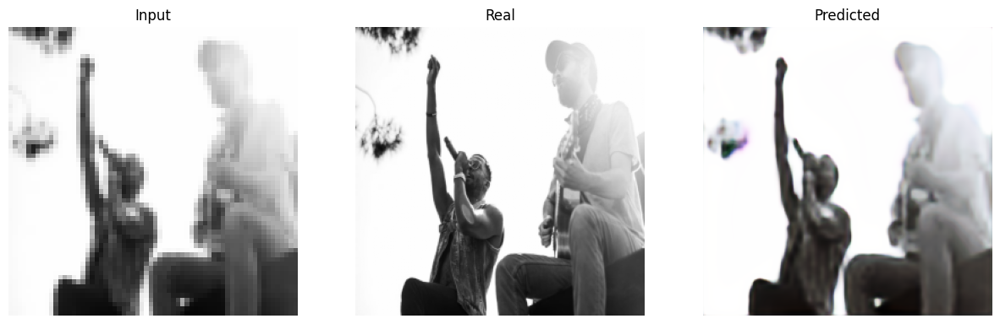

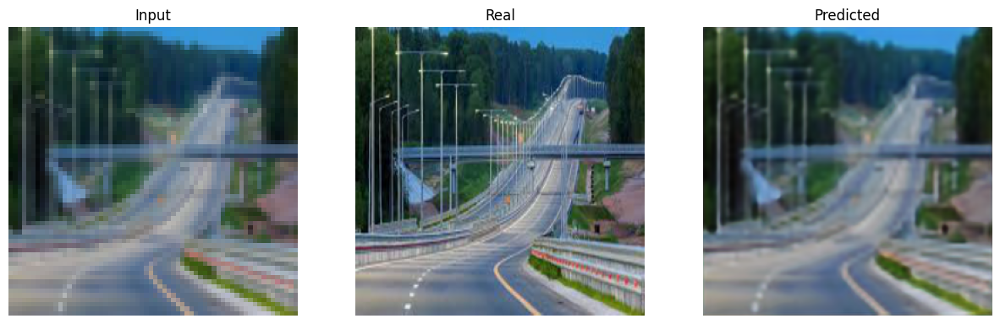

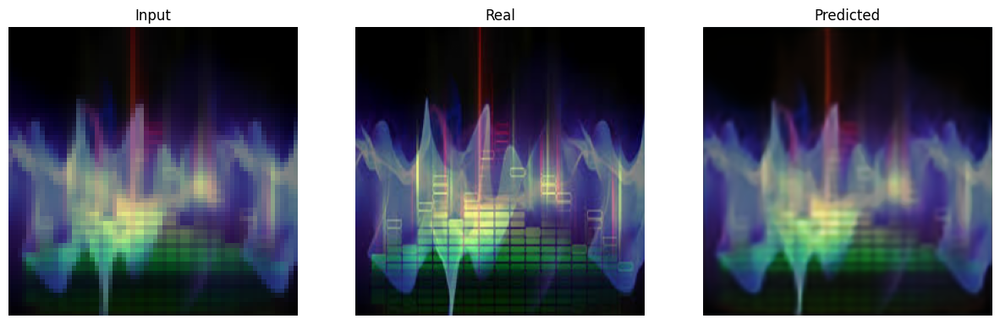

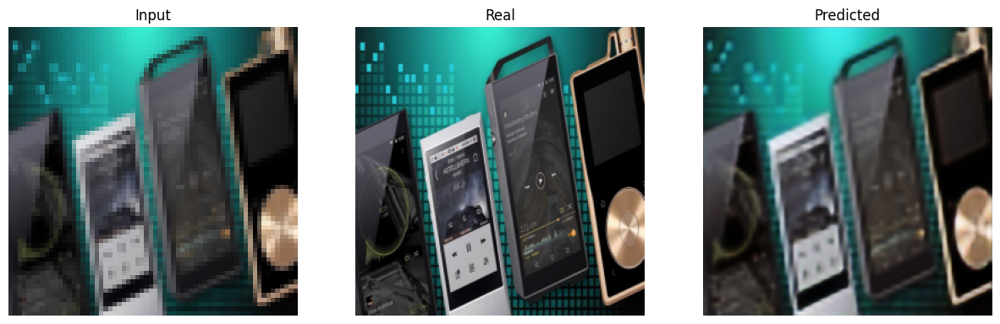

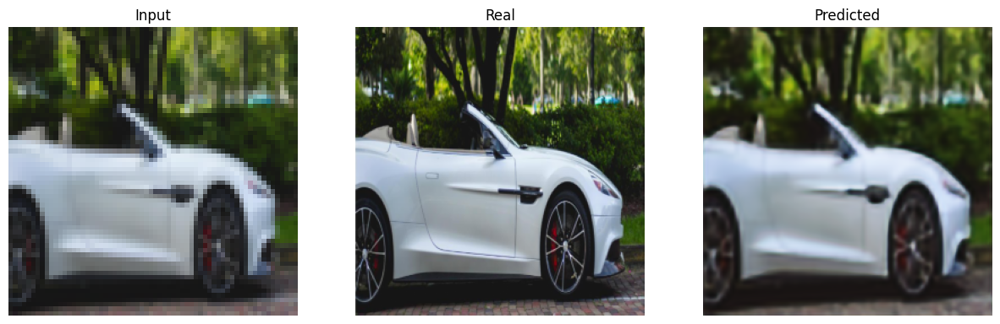

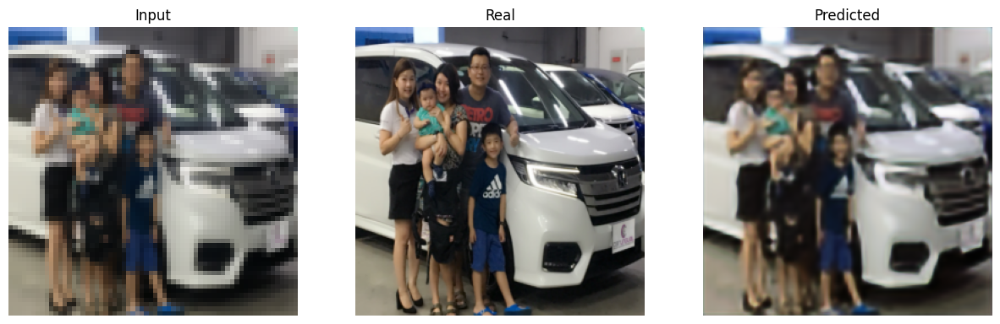

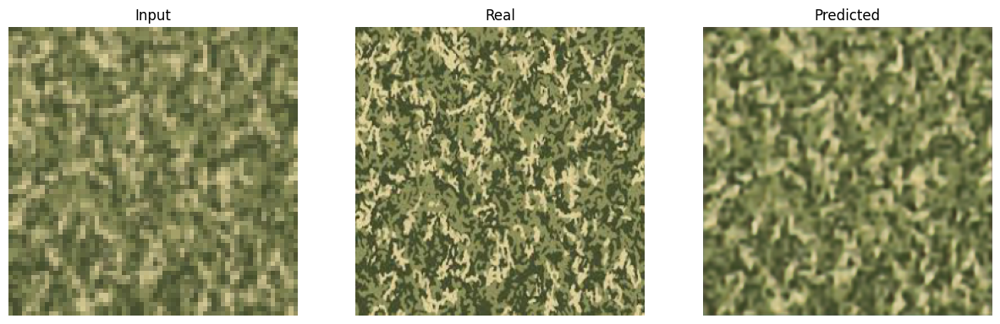

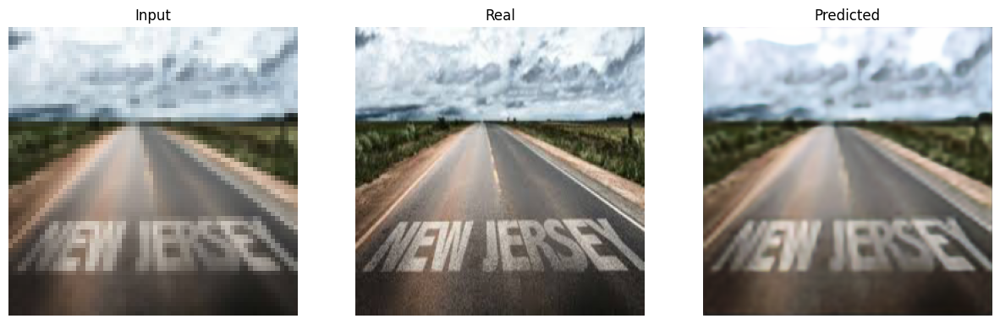

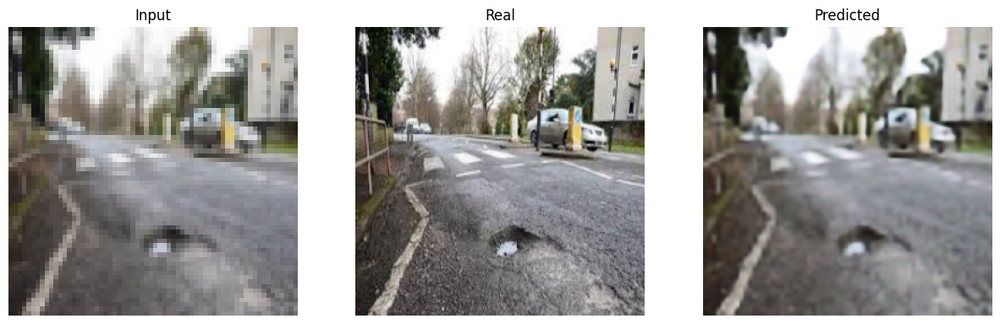

In [30]:
predict_and_display(unet_model, test_loader, device)

#**```Skip Connection is WAYYYYYY better than non-skip connection, not only because it helps alleviate the effect of Vanishing Gradient, concatenating the features pre-encoder helps it saves some information and suffer less information loss when encoding```**